In [21]:
import os
os.chdir('/home/tzd/fs03/d1/tzd/Data_analysis/RAworkflow')
%run ./DataSetUP10VAR.ipynb
#FmodelDF

boxes().shape[0]
# getNoASGM():       => Hg0no_ASGM dataframe; in correct units
# get_model(region): => Hg0_modified; in correct units (takes gridbox region in Peru as input)
# getLoRes():        => Hg0 baseline with ASGM low resulution in correct units
# getHiRes():        => Hg0 baseline with ASGM high resulution in correct units
# getNoASGM():       => Hg0 baseline without ASGM low resulution in correct units
# get_obs_d():       => obs_Hg0; original observations daily mean values
# get_detrended_obs(): => Obs_detrended; return detrended observations
# get_detrended_model(model): => This function takes in a dataframe of model outputs 
                                and returns the detrended version of that model output
# getObsIQR(obs): This function takes observations and returns the IQR 
# getIQR_Dd(model): This function takes in a dataframe of model outputs and returns the detrended IQR
# getIQR(model): => This function takes in a dataframe of model outputs and returns the IQR
#

In [22]:
import numpy as np
import matplotlib.pyplot as plt
import emcee
import corner
from scipy.stats import norm

# Formular for Calculating Emission Signal from each gridbox
$$\small{Y_{signal}} =\small\frac{(X_{modified}-X_{base})}{(M_1-M_0)}\small{(M-M_o)}$$

* $\small{Y_{signal}}$ : The Emission signal from a gridbox

* $X_{modified}$ : The modified emissions GEOS Chem output __(model output)__
* $X_{base}$ : The baseline emissions GEOS Chem output __(model output)__
* $M_1$ : The Hg mass after modification __(known)__
* $M_0$ : The Hg mass before modification __(known)__
* $M$ : The intended Hg emissions mass __(unknown)__

The above equation can be expanded in to separate the uknowns from the known information so that $M$ can be used as a parameter in our optimization

$$\small{Y_{signal}} =\small\frac{(X_{modified}-X_{base})}{(M_1-M_0)}M-\small\frac{(X_{modified}-X_{base})}{(M_1-M_0)}M_o$$

let $$W_{region}=\small\frac{(X_{modified}-X_{base})}{(M_1-M_0)}$$

hence the above equation becomes:
$$\small{Y_{signal}} =W_{region}M-W_{region}M_o$$

## Optimization of combined signal from differnt gridboxes 

The modified model output at Chalcataya accounting for signals from the different regions is given by the equation: 

$$Hg_{(modified)}= HgSignal_{(MdD )}+ HgSignal_{(S-Puno)} + HgSignal_{(N-Puno)}+ HgSignal_{(Apurimac)}+ HgSignal_{(Arequipa)}+HgBaseline_{(No-ASGM)}$$

$$Hg_{(modified)}= (W_{(MdD)}M-W_{(MdD)}M_o)+ (W_{(S-Puno)}M-W_{(S-Puno)}M_o) + (W_{(N-Puno)}M-W_{(N-Puno)}M_o)+ (W_{(Apurimac)}M-W_{(Apurimac)}M_o)+  (W_{(Arequipa)}M-W_{(Arequipa)}M_o)+HgBaseline_{(No-ASGM)}$$

$M$  is the parameter that we want to modify hence let $θ=M$ and combine all the  $−𝑊_{(𝑀𝑑𝐷)}𝑀$  in to one constant  $Z$  which leads to the simplified equation:

$$Hg_{(modified)}= (HgBaseline_{(no-ASGM)}θ_0 + Z\theta_1 + W_{(mdd)}θ_2+ W_{(s-pun)}θ_3 + W_{(n-pun)}θ_4+ W_{(aprc)}θ_5+  W_{(aqpa)}θ_6$$



# Model: Y = f(theta)
$$Y=\begin{bmatrix} (Hg_{(no-ASGM base)})& Z & W_{(mdd)} & W_{(s-pun)} & W_{(n-pun)} &W_{(aprc)} &W_{(aqpa)}\end{bmatrix} × \begin{bmatrix} \theta_0 \\θ_1 \\ θ_2\\ θ_3\\ θ_4\\ θ_5 \\ θ_6\end{bmatrix}$$ 

where $\theta_0 =\theta_1=1$



In [23]:
def model(theta):
    """Dummy model used here for Bayesian analysis (replace with actual GEOS-Chem function):
        Model: Y = f(theta) where theta is a set of parameters:
            Emissions: E1, E2, and E3
    """
    Espun, Enpun, Emdd, Eaqp, Eapr=theta
    
    modified=ConstantTerm+ (Espun*Spun_sigs) + (Enpun*Npun_sigs) + (Emdd*Mdd_sigs) +(Eaqp*Aqp_sigs) +Eapr*Apr_sigs 

    
    #create 
    
     
    summary =pd.DataFrame(modified)
    # Dummy version of model for testing
    #print(summary)
    #meanMod = summary[0][1]
    #print(meanMod)
    nineth= list(summary.apply(find_90th))
    
    #IQR = summary[0][6]-summary[0][4]
    model = nineth
    #print(model)
    return model

In [24]:
#Testing Modelling function
thet = [10,13,60,25,1]
model(thet)

[0.5506790280342102,
 0.581397294998169,
 0.47169095277786255,
 0.3188995122909546,
 0.24834346771240234,
 0.20081913471221924,
 0.2151550054550171,
 0.24219882488250732,
 0.358703076839447,
 0.5106285214424133,
 0.4732983112335205,
 0.3577360212802887,
 0.4207282066345215]

In [25]:
def lnlike(theta, y_obs, y_err):
    """Calculating log likelihood assuming iid Gaussian errors
       Parameters
       ----------
       theta : parameters
       y_obs : observed value (e.g. of IQR)
       y_err : error in observed value (e.g. of IQR)

    """
    y = model(theta) # calculate modelled output
    # calculate log-likelihood that observed value is drawn from normal
    # distribution with mean y (modelled value) and sigma = y_err
    LnLike = sum(norm.logpdf(y_obs, y, y_err))
    return LnLike

In [26]:
def lnprior(theta):
    """Apply prior assumption bounds (i.e. upper and lower bounds of variables)
       Parameters
       ----------
       theta : parameters    
    """
    
    E1, E2, E3, E4, E5 = theta
    
    # Prior assumptions for emissions - vary between 0 and 100 (can adjust this):
    min_emiss = 0
    max_emiss = 100 
    
    if E1 <= min_emiss or E2 <= min_emiss or E3 <= min_emiss or E4 <= min_emiss or E5 <= min_emiss: # enforce lower bound
        return -np.inf
    elif E1 >= max_emiss or E2 >= max_emiss or E3 >= max_emiss or E4 >= max_emiss or E5 >= max_emiss: # enforce upper bound
        return -np.inf
    else: # all values within prior bounds
        return 0.0
    

In [27]:
def lnprob(theta, y_obs, y_err):
    """Overall function that calculates log likelihood probability
       Parameters
       ----------
       theta : parameters  
       y_obs : observed value (e.g. of IQR)   
       y_err : error in observed value (e.g. of IQR)      
    """
    
    lp = lnprior(theta) #call lnprior
    if not np.isfinite(lp): # check if lp is non-zero:
        return -np.inf
    else: #recall if lp not -inf, its 0, so this just returns likelihood
        return lp + lnlike(theta, y_obs, y_err) 


In [28]:
regions


['spun', 'npun', 'mdd', 'aqp', 'apr']

In [29]:

y_err = 0.05
#theta_true = (E1_true, E2_true, E3_true,E4_true, E5_true)
y_true =GBaround90th() #getObsIQR(get_detrended_obs())#model(theta_true)
# y_obs = y_true + np.random.normal(0, y_err) # option if have many "observations" of certain output

In [30]:

# initial guess for variables E1, E2, E3
initial = np.array([7.75, 11.66, 1.39, 13.63, 18.99]) 

ndim = len(initial)
# hyperparameter for jump size between guesses
step_size = 1e-5 
# number of chains to run simultaneously and their length
nwalkers = 50
niter = 1000

# setting initial guesses for all of the chains
p0 = [np.array(initial) + step_size * np.random.randn(ndim) for i in range(nwalkers)]

sampler = emcee.EnsembleSampler(nwalkers,ndim,lnprob, args=(y_true, y_err))
print("Running burn-in...")
p0, _, _ = sampler.run_mcmc(p0, 500)
sampler.reset()

print("Running production...")
pos, prob, state = sampler.run_mcmc(p0, niter)

Running burn-in...
Running production...


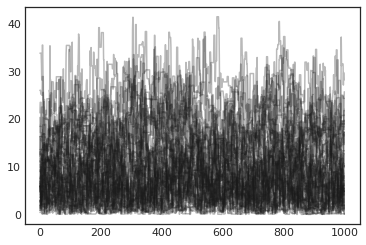

In [31]:
#%% Plot chain results
res=plt.plot(sampler.chain[:,:,4].T, '-', color='k', alpha=0.3)
#plt.axhline(E2_true, color='blue')

In [32]:
#%% Plot chain results
print("""res=plt.plot(sampler.chain[:,:,4].T, '-', color='k', alpha=0.3)""")
#plt.axhline(E2_true, color='blue')

res=plt.plot(sampler.chain[:,:,4].T, '-', color='k', alpha=0.3)


In [33]:
print("sampler.chain[:,:,4].T")

sampler.chain[:,:,4].T


In [34]:
from numpy import *
m_Spun,m_Npun,m_Mdd,m_Aqp,m_Apr = median(sampler.flatchain, axis=0)



In [35]:
median(sampler.flatchain, axis=0)

array([ 5.43555072,  8.6171773 , 12.91681093, 27.55226665,  9.14959329])

In [36]:
corner.quantile(samples,[0.1,0.5,0.9] , weights=None)

NameError: name 'samples' is not defined

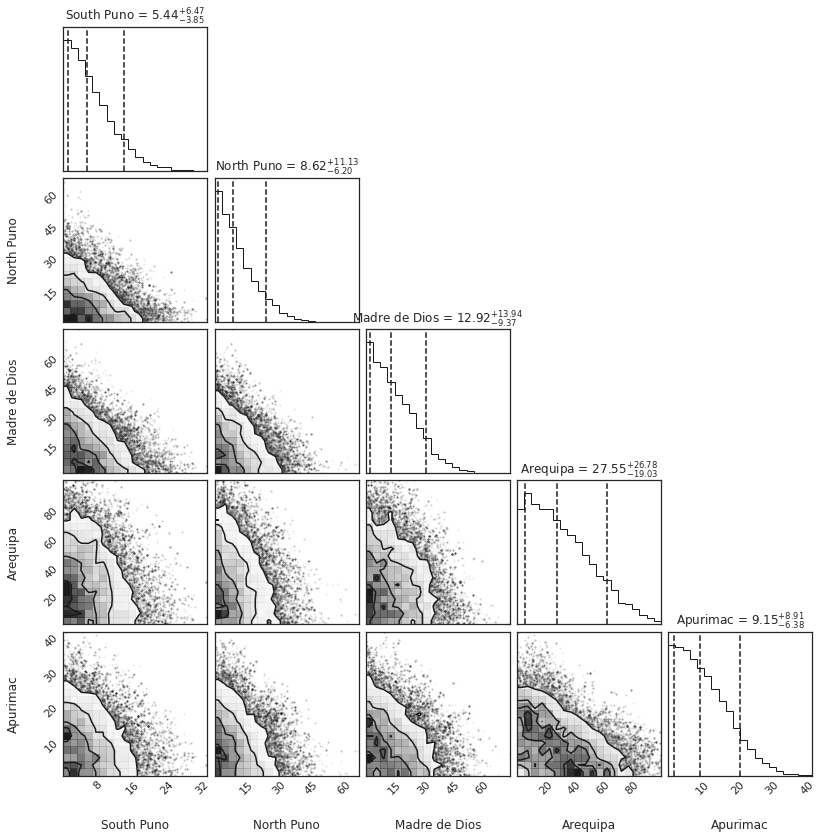

In [37]:

#%% Plot corner plots to visualize 1D and 2D spreads between the parameters we are testing, and get some uncertainties on our paraemter estimations
labels = ['South Puno','North Puno','Madre de Dios','Arequipa','Apurimac']
samples = sampler.flatchain
fig = corner.corner(samples,show_titles=True,labels=labels,plot_datapoints=True,quantiles=[0.10, 0.5, 0.90])
#fig.supxlabel("Corner Plots to Visualize 1D and 2D Spreads Between the Emission Amounts Being Tested\n",fontsize=16)

In [38]:

#%% Plot corner plots to visualize 1D and 2D spreads between the parameters we are testing, and get some uncertainties on our paraemter estimations
print("""
labels = ['South Puno','North Puno','Madre de Dios','Arequipa','Apurimac']
samples = sampler.flatchain
fig = corner.corner(samples,show_titles=True,labels=labels,plot_datapoints=True,quantiles=[0.10, 0.5, 0.90])
#fig.supxlabel("Corner Plots to Visualize 1D and 2D Spreads Between the Emission Amounts Being Tested\n",fontsize=16)""")


labels = ['South Puno','North Puno','Madre de Dios','Arequipa','Apurimac']
samples = sampler.flatchain
fig = corner.corner(samples,show_titles=True,labels=labels,plot_datapoints=True,quantiles=[0.10, 0.5, 0.90])
#fig.supxlabel("Corner Plots to Visualize 1D and 2D Spreads Between the Emission Amounts Being Tested
",fontsize=16)


In [39]:
samples.shape

(50000, 5)

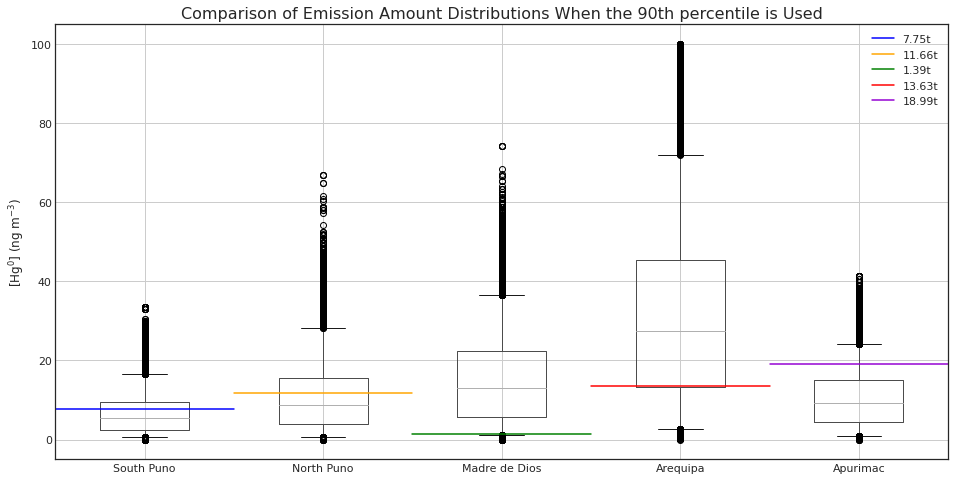

In [45]:
import plotly.express as px
import plotly.graph_objects as go
dfSamples=pd.DataFrame(samples,columns=labels)
#fig = px.box(dfSamples, points="all")
#fig.show()
fig= plt.figure( figsize=[16,8])
ax= fig.add_subplot(111)
bpdict = dfSamples.boxplot(whis=[5, 95], return_type='dict')

ax.axhline(7.75,xmin=0, xmax=0.20,color = 'blue',label='7.75t')
ax.axhline(11.66, xmin=0.20, xmax=0.40,color = 'orange',label='11.66t')
ax.axhline(1.39, xmin=0.40, xmax=0.60,color = 'green',label='1.39t')
ax.axhline(13.63, xmin=0.6, xmax=0.8,color = 'red',label='13.63t')
ax.axhline(18.99, xmin=0.80, xmax=1,color = 'darkviolet',label='18.99t')
ax.legend()
ax.set_ylabel('[Hg$^0$] (ng m$^{-3}$)')
ax.set_title('Comparison of Emission Amount Distributions When the 90th percentile is Used', fontsize=16)
plt.show()


In [42]:
print('dfSamples[labels[0]]')

dfSamples[labels[0]]


In [43]:
colors = ['rgba(93, 164, 214, 0.5)', 'rgba(255, 144, 14, 0.5)', 'rgba(44, 160, 101, 0.5)',
          'rgba(255, 65, 54, 0.5)', 'rgba(207, 114, 255, 0.5)']
y_data=[dfSamples[labels[0]],dfSamples[labels[1]],dfSamples[labels[2]],dfSamples[labels[3]],dfSamples[labels[4]]]

x_data = labels

fig = go.Figure()

for xd, yd, cls in zip(x_data, y_data, colors):
        fig.add_trace(go.Box(
            y=yd,
            name=xd,
            whiskerwidth=0.2,
            fillcolor=cls,
            line_width=1)
        )

fig.update_layout(
    title='Box Plots Showing Distributions of the Emissions from Each Region',
    yaxis=dict(
        autorange=True,
        showgrid=True,
        zeroline=True,
        dtick=5,
        gridcolor='rgb(255, 255, 255)',
        gridwidth=1,
        zerolinecolor='rgb(255, 255, 255)',
        zerolinewidth=2,
    ),
    margin=dict(
        l=40,
        r=30,
        b=80,
        t=100,
    ),
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
    showlegend=False
)

fig.show()

In [97]:
for i in range(len(labels)):
    fig = go.Figure(data=[go.Histogram(x=dfSamples[labels[i]], histnorm='probability density')])

    fig.show()